# Compare Average Bubbles

In [1]:
import numpy as np
from numpy import load
import math
import matplotlib
from matplotlib import gridspec
import matplotlib.pyplot as plt
import scipy as scp
import scipy.optimize as sco
import scipy.signal as scs
import scipy.special as ssp
import operator as op
import statistics as stat
from itertools import zip_longest, compress, count, islice, groupby, cycle, chain
import os
import pywt
import scipy.ndimage
from scipy.ndimage import gaussian_filter1d, gaussian_filter
#import cv2
from PIL import Image

In [2]:
np_load_old = np.load
np.load = lambda *a,**k: np_load_old(*a, allow_pickle=True, **k)

### Simulation Parameters 

In [3]:
nLat = 4096
nu = 2.*10**(-3)
lenLat = 2 * 50. / np.sqrt(2. * nu)
nyq = nLat//2+1
spec = nyq
hLat = nLat//2
dx = lenLat/nLat
dk = 2.*np.pi/lenLat

def source(ss):
    if ss == 'thin':
        # thin wall
        nSims = 390
        lamb = 6
        m2eff = 4. * nu * (- 1. + lamb**2)
        phi0 = 2. * np.pi / 7.
        V = lambda phi : (-np.cos(phi)+0.5*lamb**2.*np.sin(phi)**2.)*4.*nu
        instanton_location = '/home/dpirvu/inst/instantons/dev/thin_wall_instanton_sim.dat'
        sim_location = lambda sim: '/gpfs/dpirvu/sims/x'+str(nLat)+'_phi0{:.4f}'.format(phi0)+'_lambda{:.4f}'.format(lamb)+'_sim'+str(sim)+'_fields.dat'
        coleman_profile = np.pi+np.genfromtxt(instanton_location)[:,0] # theoretical bubble profile
        plots_file = '/home/dpirvu/big_plot_file/thin_wall_average_bubble/'
        pickle_location = '/home/dpirvu/pickle_location/thin_wall_average_bubble/old_'
        cutout_location = '/gpfs/dpirvu/thin_wall_average_bubble/'
        suffix = '_for_phi0{:.4f}'.format(phi0)+'_len{:.4f}'.format(lenLat)+'_lamb{:.4f}'.format(lamb)+'_x'+str(nLat)
    if ss == 'free':
        # thin wall
        nSims = 10
        lamb = 6
        m2eff = 4. * nu * (- 1. + lamb**2)
        phi0 = 2. * np.pi / 7.
        V = lambda phi : (-m2eff*phi)**2*4.*nu
        instanton_location = '/home/dpirvu/inst/instantons/dev/thin_wall_instanton_sim.dat'
        sim_location = lambda sim: '/gpfs/dpirvu/sims/free_x'+str(nLat)+'_phi0{:.4f}'.format(phi0)+'_lambda{:.4f}'.format(lamb)+'_sim'+str(sim)+'_fields.dat'
        coleman_profile = np.pi+np.genfromtxt(instanton_location)[:,0] # theoretical bubble profile
        plots_file = '/home/dpirvu/big_plot_file/free_field_peak_correlator/'
        pickle_location = '/home/dpirvu/pickle_location/free_field_peak_correlator/'
        cutout_location = '/gpfs/dpirvu/sims/'
        suffix = '_for_free_phi0{:.4f}'.format(phi0)+'_len{:.4f}'.format(lenLat)+'_x'+str(nLat)
    elif ss == 'thick':
        # thick wall
        nSims = 100
        lamb = 1.5
        m2eff = 4. * nu * (- 1. + lamb**2)
        phi0 = 2. * np.pi / 4.
        V = lambda phi : (-np.cos(phi)+0.5*lamb**2.*np.sin(phi)**2.)*4.*nu
        instanton_location = '/home/dpirvu/inst/instantons/dev/thick_wall_instanton_sim.dat'
        sim_location = lambda sim: '/gpfs/dpirvu/sims/x'+str(nLat)+'_phi0{:.4f}'.format(phi0)+'_lambda{:.4f}'.format(lamb)+'_sim'+str(sim)+'_fields.dat'
        coleman_profile = np.pi+np.genfromtxt(instanton_location)[:,0] # theoretical bubble profile
        plots_file = '/home/dpirvu/big_plot_file/thick_wall_average_bubble/'
        pickle_location = '/home/dpirvu/pickle_location/thick_wall_average_bubble/'
        cutout_location = '/gpfs/dpirvu/thick_wall_average_bubble/'
        suffix = '_for_phi0{:.4f}'.format(phi0)+'_lambda'+str(lamb)+'_len{:.4f}'.format(lenLat)+'_x'+str(nLat)
    elif ss == 'up':
        # upturned
        nSims = 100
        lamb = 6
        m2eff = 4. * nu * (- 1. + lamb**2)
        phi0 = 2. * np.pi / 7.
        phiMax = 1.59858
        AA = 10
        ppp = 3
        V = lambda x : np.piecewise(x, [x > phiMax, x <= phiMax], [lambda x: (-np.cos(x)+0.5*lamb**2.*np.sin(x)**2.)*4.*nu, lambda x: 4.*nu*(-np.cos(phiMax)+0.5*lamb**2*np.sin(phiMax)**2 + AA/ppp*np.abs(x-phiMax)**ppp)])
        instanton_location = '/home/dpirvu/inst/instantons/dev/thin_wall_instanton_sim.dat'
        sim_location = lambda sim: '/gpfs/dpirvu/sims/nonosc_x'+str(nLat)+'_phi0{:.4f}'.format(phi0)+'_lambda{:.4f}'.format(lamb)+'_sim'+str(sim)+'_fields.dat'
        coleman_profile = np.pi+np.genfromtxt(instanton_location)[:,0] # theoretical bubble profile
        plots_file = '/home/dpirvu/big_plot_file/non_osc_thin_wall_average_bubble/'
        pickle_location = '/home/dpirvu/pickle_location/non_osc_thin_wall_average_bubble/'
        cutout_location = '/gpfs/dpirvu/non_osc_thin_wall_average_bubble/'
        suffix = '_for_phi0{:.4f}'.format(phi0)+'_len{:.4f}'.format(lenLat)+'_lambda{:.4f}'.format(lamb)+'_x'+str(nLat)
    return nSims, lamb, m2eff, phi0, V, instanton_location, sim_location, coleman_profile, plots_file, pickle_location, cutout_location, suffix

titles = [r'$\phi(x)$', r'$\partial_t \phi(x)$', r'$|\nabla \phi(x)|^2$', r'$V(\phi(x))$']
def bubbles_file(min, max):
    return cutout_location+'bubbles_from_sim'+str(min)+'_up_to_sim'+str(max-1)+suffix+'.npy'
def centred_bubbles_file(min, max):
    return pickle_location+'centred_bubbles_from_sim'+str(min)+'_up_to_sim'+str(max-1)+suffix+'.npy'
def bubbles_at_rest_file(sim):
    return cutout_location+'restbubble_sim'+str(sim)+suffix+'.npy'
def average_bubble(min, max):
    return pickle_location+'average_bubble_from_sim'+str(min)+'_up_to_sim'+str(max-1)+suffix+'.npy'
def new_bubble_data(min, max):
    return pickle_location+'bubbles_sim'+str(min)+'_up_to_sim'+str(max-1)+suffix+'.npy'
def new_full_bubble_data(min, max):
    return cutout_location+'rest_bubbles_from_sim'+str(min)+'_up_to_sim'+str(max-1)+suffix+'.npy'
def average_of_N_bubbles(Nbubbles):
    return pickle_location+'average_of_'+str(Nbubbles)+'_bubbles'+suffix+'.npy'

/cm/shared/apps/conda-environments/python37/lib/python3.7/site-packages/ipykernel_launcher.py:6: PeakPropertyWarning: some peaks have a width of 0
  
/cm/shared/apps/conda-environments/python37/lib/python3.7/site-packages/ipykernel_launcher.py:6: PeakPropertyWarning: some peaks have a width of 0
  


filter_size =  173.7779557760698
filter_size =  50.64720254541112
filter_size =  173.7779557760698


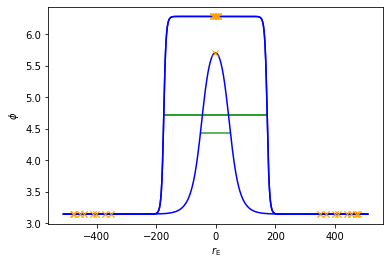

In [121]:
for test in ['thin', 'thick', 'up']: 
    nSims, lamb, m2eff, phi0, V, instanton_location, sim_location, coleman_profile, plots_file, pickle_location, cutout_location, suffix = source(test)
    xoffset = nLat//8
    temp = coleman_profile[len(coleman_profile)//2-xoffset:len(coleman_profile)//2+xoffset]
    peaks, _ = scs.find_peaks(temp)
    fwhm, height, left_ips, right_ips = scs.peak_widths(temp, peaks, rel_height=0.5)
    filter_size = max(fwhm)/2.; print('filter_size = ', filter_size)
    radius_Coleman_bubble = filter_size*dx

    plt.plot(np.arange(len(temp))-xoffset, temp, color='b')
    plt.plot(peaks-xoffset, temp[peaks], "x", color='orange')
    [plt.hlines(height[i], left_ips[i]-xoffset, right_ips[i]-xoffset, color="C2") for i in range(len(fwhm))]
    plt.xlabel(r'$r_{\rm E}$'); plt.ylabel(r'$\phi$')

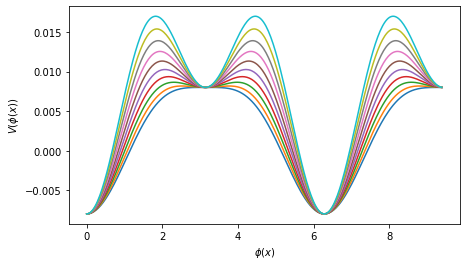

In [5]:
fig = plt.figure(figsize=(7, 4))
plt.xlabel(r'$\phi(x)$'); plt.ylabel(r'$V(\phi(x))$')
for lm in np.linspace(1, 2, 10):
    V = lambda phi : (-np.cos(phi)+0.5*lm**2.*np.sin(phi)**2.)*4.*nu
    plt.plot([i for i in np.arange(0, 3*np.pi, np.pi/100)], [V(i) for i in np.arange(0, 3*np.pi, np.pi/100)])

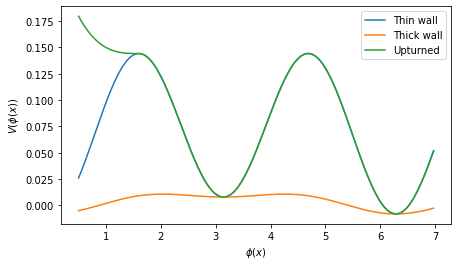

In [118]:
title_list = [r'Thin wall', r'Thick wall', r'Upturned']
fig = plt.figure(figsize=(7, 4))
plt.xlabel(r'$\phi(x)$'); plt.ylabel(r'$V(\phi(x))$')
for kkk, test in enumerate(['thin', 'thick', 'up']): 
#for test in ['thick']:
    nSims, lamb, m2eff, phi0, V, instanton_location, sim_location, coleman_profile, plots_file, pickle_location, cutout_location, suffix = source(test)
    right_phi_at_V_max = sco.minimize_scalar(lambda x: -V(x), bounds=[np.pi, 2*np.pi], method='bounded')
    left_phi_at_V_max = sco.minimize_scalar(lambda x: -V(x), bounds=[0, np.pi], method='bounded')
    plt.plot([i for i in np.arange(0.5, 7, np.pi/100)], [V(i) for i in np.arange(0.5, 7, np.pi/100)], label=title_list[kkk])
plt.legend()

### Import Oscillon Data / Average Bubbles

In [7]:
##plot deboosted bubbles
#for i in range(len(newBubbleData)):
#    fig, ax = plt.subplots(1, 1, figsize=(7,5))
#    im = ax.imshow(newBubbleData[i], aspect='auto', interpolation='none', origin='lower')
#    clb = plt.colorbar(im, ax = ax)
#    plt.show()

In [8]:
##plot average bubble, mom_bubble, ge_bubble, pe_bubble, ke_bubble
#fig, ax = plt.subplots(1, len(ab), figsize=(25, 5))
#for col in range(len(ab)):
#    im = ax[col].imshow(ab[col], aspect='auto', interpolation='none', origin='lower')
#    clb = plt.colorbar(im, ax = ax[col])
#plt.savefig(plots_file+'average_bubble'+suffix+'.png')

In [31]:
def coleman_match(bubble, colemanSoln):
    T, N = len(bubble), len(bubble[0])
    for t in range(T):
        a = sum([(gaussian_filter1d(bubble[t], sigma=10)[x] - colemanSoln[x])**2. for x in range(200, 800)])
        if t == 0 or a < minSum:
            minSum, tColeman = a, t
    return tColeman

def time_at_fraction(bubble, frac, limit):
    T, N = len(bubble), len(bubble[0])
    right_phi_x = [np.sum([1 for x in slice if x >= limit]) for slice in bubble]
    time_list = [t if (right_phi_x[t] <= N*frac) else 0 for t in range(T)]
    return next((t for t in time_list[::-1] if t != 0), 0)

def plot_coleman_match(bubble, error_bubble, colemanSoln, bool):
    T, N = len(bubble), len(bubble[0])
    colemanSoln = colemanSoln[len(colemanSoln)//2-N//2:len(colemanSoln)//2+N//2]
    tcoleman = coleman_match(bubble, colemanSoln)
    slice, err_slice = bubble[tcoleman], error_bubble[tcoleman]

    if bool:
        fig = plt.figure(figsize=(15,5))
        plt.errorbar(np.arange(N), slice, yerr = err_slice, color = 'k', marker='o', ms=1, alpha = 0.2, ecolor = 'green', label = 'Slice at t')
        plt.errorbar(np.arange(N), gaussian_filter1d(slice, sigma=10), yerr = err_slice, color = 'b', marker='o', ms=1, alpha = 0.5, ecolor = 'orange', label = 'Best match')
        plt.plot(np.arange(N), colemanSoln, 'r-', label = 'Best match t = '+str(tcoleman)); plt.legend()
        plt.savefig(plots_file+'average_bubble_profile'+suffix+'.png')

        fig, ax = plt.subplots(1, 1, figsize=(6,5))
        im = plt.imshow(bubble, aspect='auto', interpolation='none', origin='lower')
        clb = plt.colorbar(im, ax = ax)
        clb.set_label(r'$\phi(x)$', labelpad=-25, y=1.08, rotation=0)
        ax.set_xlabel(r'$\bar{x}$')
        ax.set_ylabel(r'$\bar{t}$')
#        ax.set_ylim((len(bubble)-800, len(bubble)-200))
        ax.plot(np.arange(N), np.ones(N)*tcoleman, 'r-')
    return tcoleman

def bubble_total_energy(KED, GED, PED):
    T, N = len(KED), len(KED[0])
    KE = [sum(KED[t]) for t in range(T)]
    GE = [sum(GED[t]) for t in range(T)]
    PE = [sum(PED[t]) for t in range(T)]
    TE = [sum(x) for x in zip(KE, GE, PE)]
    return KE, GE, PE, TE

def plot_total_energy_density(KED, GED, PED, tcoleman):
    energies = [KED, GED, PED, KED + GED + PED]
    titles = [r'$\frac{1}{2}(\partial_t \phi)^2$', r'$\frac{1}{2}|\nabla \phi|^2$', r'$V(\phi)$', r'$\frac{1}{2}(\partial_t \phi)^2 +\frac{1}{2}|\nabla \phi|^2+V(\phi)$']

    fig, ax = plt.subplots(2, 2, figsize=(15,10))
    N = len(KED[0])
    for i in range(4):
        if i in [0,1]: j = 0
        else: j = 1
        im = ax[i%2][j].imshow(energies[i], aspect='auto', interpolation='none', origin='lower') 
        clb = plt.colorbar(im, ax = ax[i%2][j]); ax[i%2][j].set_title(titles[i]); ax[i%2][j].set(ylabel=r'$t$')
        ax[i%2][j].plot(np.arange(N), np.ones(N)*tcoleman, 'r-')
    plt.savefig(plots_file+'energy_densities_from_average'+suffix+'.png');
    return

def plot_total_energy(KED, GED, PED, tcoleman):
    energies = bubble_total_energy(KED, GED, PED)
    titles = ['KE', 'GE', 'PE', 'TE']
    ls = ['b-', 'g-', 'y-', 'r-']
    N = len(energies[0])
    fig = plt.figure(figsize=(8,5))
    for i in range(len(energies)):
        plt.plot(np.arange(N), energies[i], ls[i], label = titles[i])
    plt.axhline(np.mean(energies[-1]), color = 'darkgray', ls = '--')
    plt.axvline(tcoleman, color = 'darkgray', ls = '--')
    plt.xlabel('$t$'); plt.legend(); plt.savefig(plots_file+'energies'+suffix+'.png'); plt.show()
    return

def plot_energy_dens_at_t(KED, GED, PED, timeslice):
    TED = [sum(x) for x in zip(KED, GED, PED)]
    energies = [KED, GED, PED, TED]
    titles = ['KED', 'GED', 'PED', 'TED']
    ls = ['b-', 'g-', 'y-', 'r-']
    N = len(KED[0])
    
    fig = plt.figure(figsize=(8,8)); plt.subplots_adjust(hspace=.0)
    gs = gridspec.GridSpec(len(energies), 1, height_ratios=[1]*len(energies))
    ax = [[]]*len(energies); ax[0] = plt.subplot(gs[0])
    for i in range(1, len(ax)): ax[i] = plt.subplot(gs[i], sharex = ax[i-1])
    for i in range(len(ax)):
        ax[i].plot(np.arange(N), energies[i][timeslice], ls[i], label = titles[i])
        if i == 0:
            ax[i].axhline(np.pi, color = 'darkgray', ls='--')
        else:
            ax[i].axhline(np.mean(energies[i][timeslice]), color = 'darkgray', ls='--')            
        ax[i].legend()
    ax[-1].set(xlabel='$x$')
    plt.savefig(plots_file+'energy_densities_at_t'+str(timeslice)+suffix+'.png'); plt.show()
    return

def GradEnDen(field):
    Nx = len(field)
    NNx = Nx//2+1
    fft_field = scp.fft.rfft(field)
    for i in range(len(fft_field)):
        fft_field[i] = 1j*i*dk * fft_field[i]
    real_field = scp.fft.irfft(fft_field)
    return [0.5*i**2 for i in real_field]

def plot_derived_total_energy_density(field, momentum, filter, t_coleman):
    smooth_field = [gaussian_filter1d(slice, sigma=filter) for slice in field]
    smooth_momentum = [gaussian_filter1d(slice, sigma=filter) for slice in momentum]
    KED = [0.5*slice**2. for slice in smooth_momentum]
    GED = [GradEnDen(slice) for slice in smooth_field]
    PED = [V(slice) for slice in smooth_field]
    TED = [[KED[t][x]+GED[t][x]+PED[t][x] for x in range(len(KED[0]))] for t in range(len(KED))]
    energies = [KED, GED, PED, TED]
    titles = [r'$\frac{1}{2}(\partial_t \phi)^2$', r'$\frac{1}{2}|\nabla \phi|^2$', r'$V(\phi)$', r'$\frac{1}{2}(\partial_t \phi)^2 +\frac{1}{2}|\nabla \phi|^2+V(\phi)$']

    fig, ax = plt.subplots(2, 2, figsize=(15,10))
    N = len(smooth_field[0])
    for i in range(4):
        if i in [0,1]: j = 0
        else: j = 1
        im = ax[i%2][j].imshow(energies[i], aspect='auto', interpolation='none', origin='lower') 
        clb = plt.colorbar(im, ax = ax[i%2][j]); ax[i%2][j].set_title(titles[i]); ax[i%2][j].set(ylabel=r'$t$')
        ax[i%2][j].plot(np.arange(N), np.ones(N)*t_coleman, 'r-')
    plt.savefig(plots_file+'energy_densities'+suffix+'.png');
    return

def plot_TE_with_Nbubbles(TColeman, plot):
    tcoleman = 2500 - TColeman
    bubble_averages_list = []
    for nN in range(nSims):
        bool = os.path.exists(average_of_N_bubbles(nN))
        if bool:
            nBubs = nN
            bubble_averages_list.append(np.load(average_of_N_bubbles(nN)))

#    fig = plt.figure(figsize=(8,6))
#    for bubble_average in bubble_averages_list:
#        ab, _, _ = bubble_average
#        bubble, mom_bubble, ge_bubble, pe_bubble, ke_bubble = ab
#        energies = bubble_total_energy(ke_bubble, ge_bubble, pe_bubble)
#        plt.plot(np.arange(np.abs(2500-len(energies[-1])), 2500)[-1500:], energies[-1][-1500:], label = length)
#        plt.axhline(np.mean(energies[-1]), color = 'darkgray', ls = '--')
#    plt.axvline(TColeman, color = 'darkgray', ls = '--')
#    plt.xlabel('$t$'); plt.legend()
#    plt.savefig(plots_file+'TE_vs_nbubbles1'+suffix+'.png');

    if plot:
        fig = plt.figure(figsize=(8,6))
        for bubble_average in bubble_averages_list:
            ab, error_ab, length = bubble_average
            bubble, mom_bubble, ge_bubble, pe_bubble, ke_bubble = ab
            GED, PED, KED = ge_bubble[-tcoleman], pe_bubble[-tcoleman], ke_bubble[-tcoleman]
            TED = GED + PED + KED
            plt.plot(length, sum(TED), 'ro')#, np.mean(TED))
        plt.xlabel('$N$'); plt.ylabel('$E$'); plt.legend()
        plt.savefig(plots_file+'TE_vs_nbubbles2'+suffix+'.png');
    return nBubs

def smoothen(slice, size):
    slice = np.fft.rfft(slice)
    window = [np.exp(-0.5*(dk*k*size*dx)**2) if k <= spec else 0 for k in range(len(slice))]
    slice = [window[k]*slice[k] for k in range(len(slice))]
    return np.fft.irfft(slice)

def plot_TE_with_filter(tcoleman, nBubs):
    print(nBubs)
    bubble_average = np.load(average_of_N_bubbles(nBubs))
    ab, error_ab, length = bubble_average
    bubble, mom_bubble = ab[0], ab[1]
    slice = bubble[tcoleman]
    mom_slice = mom_bubble[tcoleman]

    fig = plt.figure(figsize=(8,6))
    for filter in range(1, 100, 1):
        smooth_field = gaussian_filter1d(slice, sigma=filter)#, mode='nearest')
        smooth_momentum = gaussian_filter1d(mom_slice, sigma=filter)#, mode='nearest')
        KED = 0.5*smooth_momentum**2.
        GED = GradEnDen(smooth_field)
        PED = V(smooth_field)
        TED = KED + GED + PED
        plt.plot(filter, np.sum(TED), 'ro', ms=2)#, 'o', label='{:.3f}'.format(filter))
    print('TE ', np.sum(TED))
    plt.axhline(0, ls='--', color='darkgray')
    plt.xlabel(r'$\sigma$'); plt.ylabel('$E$')#; plt.legend()
    plt.savefig(plots_file+'TE_vs_filter'+suffix+'.png');
    return

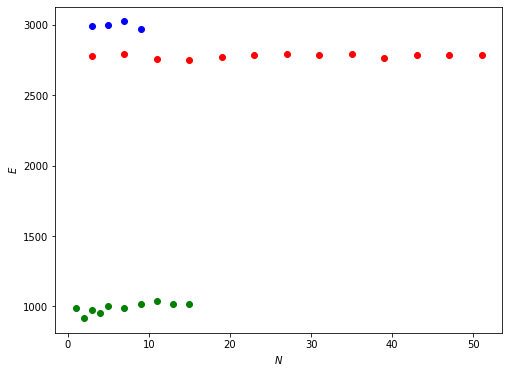

In [10]:
# Total energy at Tc function of number of bubbles in average bubble
colours = cycle(('r', 'g', 'b'))
fig = plt.figure(figsize=(8,6))
for ss in ['thin', 'thick', 'up']:
#for ss in ['thick', 'up']:
    nSims, lamb, m2eff, phi0, V, instanton_location, sim_location, coleman_profile, plots_file, pickle_location, cutout_location, suffix = source(ss)
    if ss == 'thin':
        ab, error_ab = np.load(average_bubble(0, nSims))
    else:
        ab, error_ab = np.load(average_bubble(0, nSims))
    # separate average bubble data
    bubble, mom_bubble, ge_bubble, pe_bubble, ke_bubble = ab
    error_bubble, error_mom_bubble, error_ge_bubble, error_pe_bubble, error_ke_bubble = error_ab
    TColeman = plot_coleman_match(bubble, error_bubble, coleman_profile, False)
    
    tcoleman = 2500 - TColeman
    col = next(colours)
    bubble_averages_list = []
    for nN in range(nSims):
        bool = os.path.exists(average_of_N_bubbles(nN))
        if bool:
            nBubs = nN
            bubble_averages_list.append(np.load(average_of_N_bubbles(nN)))

    for bubble_average in bubble_averages_list:
        ab, error_ab, length = bubble_average
        bubble, mom_bubble, ge_bubble, pe_bubble, ke_bubble = ab
        GED, PED, KED = ge_bubble[-tcoleman], pe_bubble[-tcoleman], ke_bubble[-tcoleman]
        TED = GED + PED + KED
        plt.plot(length, sum(TED), 'o', color=col)#, np.mean(TED))

plt.xlabel('$N$'); plt.ylabel('$E$')#; plt.legend()
plt.savefig(plots_file+'TE_vs_nbubbles'+suffix+'.png');

/home/dpirvu/.local/lib/python3.7/site-packages/scipy/ndimage/filters.py:145: RuntimeWarning: divide by zero encountered in double_scalars
  phi_x = numpy.exp(-0.5 / sigma2 * x ** 2)
/home/dpirvu/.local/lib/python3.7/site-packages/scipy/ndimage/filters.py:145: RuntimeWarning: invalid value encountered in multiply
  phi_x = numpy.exp(-0.5 / sigma2 * x ** 2)


TE  12.68321788430941
TE  10.318808438298776


/cm/shared/apps/conda-environments/python37/lib/python3.7/site-packages/ipykernel_launcher.py:62: RuntimeWarning: invalid value encountered in greater
/cm/shared/apps/conda-environments/python37/lib/python3.7/site-packages/ipykernel_launcher.py:62: RuntimeWarning: invalid value encountered in less_equal


TE  10.694056722509359


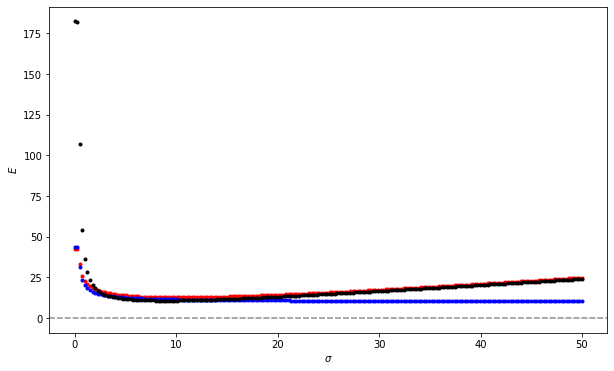

In [11]:
# Total energy at Tc function of filter size on average bubble at Tc
colours = cycle(('r', 'g', 'b', 'y', 'k', 'c'))
fig = plt.figure(figsize=(10, 6))
for ss in ['thin', 'thick', 'up']:
    nSims, lamb, m2eff, phi0, V, instanton_location, sim_location, coleman_profile, plots_file, pickle_location, cutout_location, suffix = source(ss)
    if ss == 'thin':
        ab, error_ab = np.load(average_bubble(0, nSims))
    else:
        ab, error_ab = np.load(average_bubble(0, nSims))
    # separate average bubble data
    bubble, mom_bubble, ge_bubble, pe_bubble, ke_bubble = ab
    error_bubble, error_mom_bubble, error_ge_bubble, error_pe_bubble, error_ke_bubble = error_ab
    TColeman = plot_coleman_match(bubble, error_bubble, coleman_profile, False)
    slice, mom_slice = bubble[TColeman], mom_bubble[TColeman]

    col, col2 = next(colours), next(colours)

    KED, GED, PED = 0.5*mom_slice**2., GradEnDen(slice), V(slice)
    TED = KED + GED + PED
    minTE = np.sum(TED)
    plt.plot([0], np.sum(TED), 'o', color=col, ms=3)#+'{:.2f}'.format(filter))

    for filter in np.linspace(0, 50, 200):
        smooth_field = gaussian_filter1d(slice, sigma=filter)
        smooth_momentum = gaussian_filter1d(mom_slice, sigma=filter)
        KED, GED, PED = 0.5*smooth_momentum**2., GradEnDen(smooth_field), V(smooth_field)
        TED = KED + GED + PED
        if np.sum(TED) < minTE: minTE = np.sum(TED)
        plt.plot(filter, np.sum(TED), 'o', color=col, ms=3)#+'{:.2f}'.format(filter))
    print('TE ', minTE)
    plt.axhline(0, ls='--', color='darkgray')
    plt.xlabel(r'$\sigma$'); plt.ylabel('$E$')#; plt.legend()
    plt.savefig(plots_file+'TE_vs_filter'+suffix+'.png');

2115
1975
2144


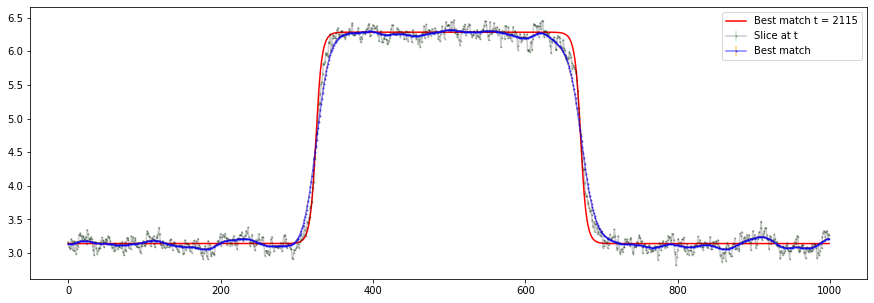

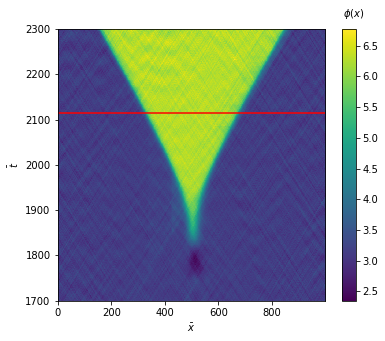

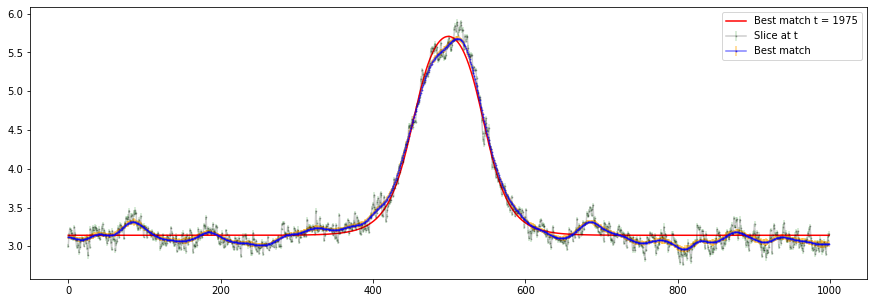

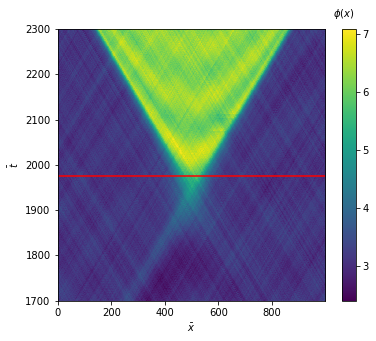

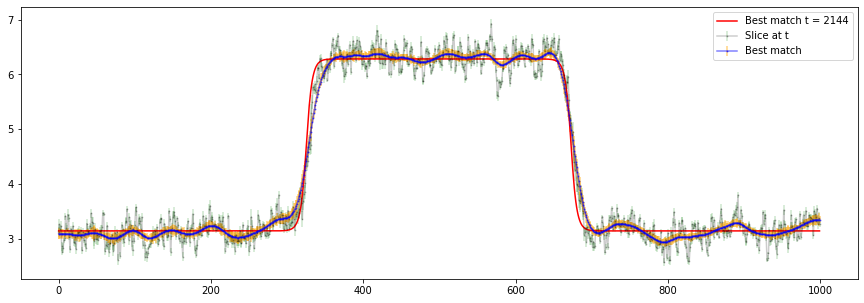

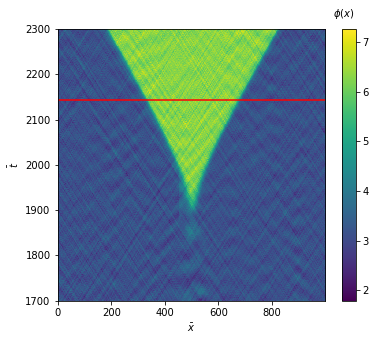

In [33]:
# Average bubbles profile at Tc best match
ABVector = []
for ss in ['thin', 'thick', 'up']:
    nSims, lamb, m2eff, phi0, V, instanton_location, sim_location, coleman_profile, plots_file, pickle_location, cutout_location, suffix = source(ss)

    # load data
    if ss == 'thin':
        ab, error_ab = np.load(average_bubble(0, nSims))
#        newBubbleData = np.load(new_bubble_data(0, nSims))
#        newfullBubbleData = np.load(new_full_bubble_data(0, nSims))
    else:
        ab, error_ab = np.load(average_bubble(0, nSims))
#        newBubbleData = np.load(new_bubble_data(0, nSims))
#        newfullBubbleData = np.load(new_full_bubble_data(0, nSims))
    # separate average bubble data
    bubble, mom_bubble, ge_bubble, pe_bubble, ke_bubble = ab
    error_bubble, error_mom_bubble, error_ge_bubble, error_pe_bubble, error_ke_bubble = error_ab
    TColeman = plot_coleman_match(bubble, error_bubble, coleman_profile, True)
    print(TColeman)

    ABVector.append(bubble)

    #plot_total_energy_density(ke_bubble, ge_bubble, pe_bubble, TColeman)
    #plot_derived_total_energy_density(bubble, mom_bubble, 1, TColeman)

    #plot_total_energy(ke_bubble, ge_bubble, pe_bubble, TColeman)
    #plot_energy_dens_at_t(ke_bubble, ge_bubble, pe_bubble, TColeman)

#    nBubs = plot_TE_with_Nbubbles(TColeman, True)
#    plot_TE_with_filter(TColeman, nBubs)

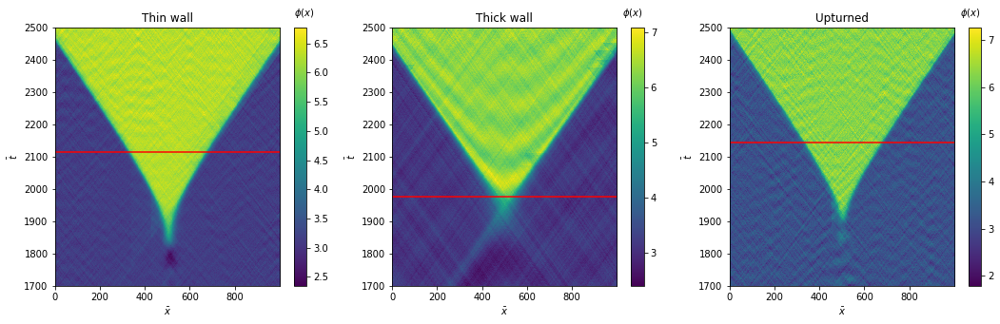

In [119]:
tcol_list = [2115, 1975, 2144]
title_list = [r'Thin wall', r'Thick wall', r'Upturned']
fig, ax = plt.subplots(1, len(abubs), figsize=(18,5))
for i in range(len(ABVector)):
    im = ax[i].imshow(ABVector[i], aspect='auto', interpolation='none', origin='lower')
    clb = plt.colorbar(im, ax = ax[i])
    clb.set_label(r'$\phi(x)$', labelpad=-25, y=1.08, rotation=0)
    ax[i].plot(np.arange(N), np.ones(N)*tcol_list[i], 'r-')
    ax[i].set_ylim((len(ABVector[i])-800, len(ABVector[i]-200)))
    ax[i].set_title(title_list[i])
    ax[i].set_xlabel(r'$\bar{x}$')
    ax[i].set_ylabel(r'$\bar{t}$')

In [34]:
abubs = [i[-800:-200] for i in ABVector]
diff = [[]]*5
for i in range(1, len(diff)+1):
    diff[i-1] = abubs[0][:-(27+i)] - abubs[-1][27+i:]

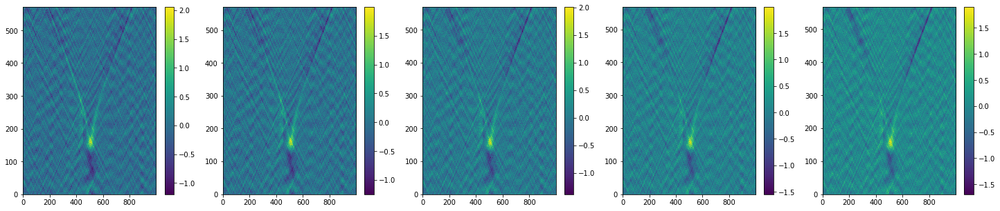

In [35]:
fig, ax = plt.subplots(1, len(diff), figsize=(len(diff)*5,5))
for i in range(len(ax)):
    im = ax[i].imshow(diff[i], aspect='auto', interpolation='none', origin='lower')
    clb = plt.colorbar(im, ax = ax[i])

### Oscillon Detection 

In [18]:
#for ss in ['thin', 'thick', 'up']:
for ss in ['thin']:
    nSims, lamb, m2eff, phi0, V, instanton_location, sim_location, coleman_profile, plots_file, pickle_location, cutout_location, suffix = source(ss)
    # load data
    if ss == 'thin':
        ab, error_ab = np.load(average_bubble(0, nSims))
        newBubbleData = np.load(new_bubble_data(0, nSims))
#        newfullBubbleData = np.load(new_full_bubble_data(0, int(nSims/2)))
    else:
        ab, error_ab = np.load(average_bubble(0, nSims))
        newBubbleData = np.load(new_bubble_data(0, nSims))
#        newfullBubbleData = np.load(new_full_bubble_data(0, nSims))

    # separate average bubble data
#    bubble, mom_bubble, ge_bubble, pe_bubble, ke_bubble = ab
#    error_bubble, error_mom_bubble, error_ge_bubble, error_pe_bubble, error_ke_bubble = error_ab

/cm/shared/apps/conda-environments/python37/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app


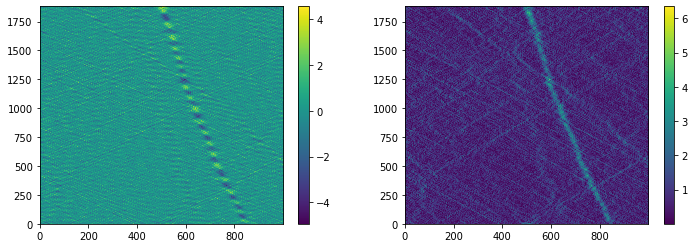

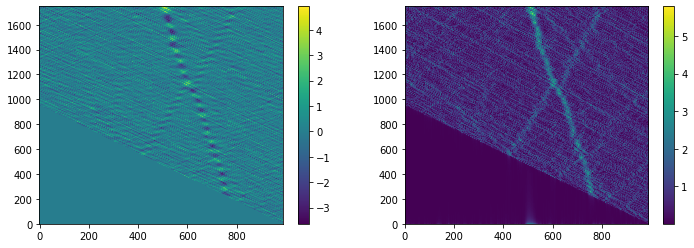

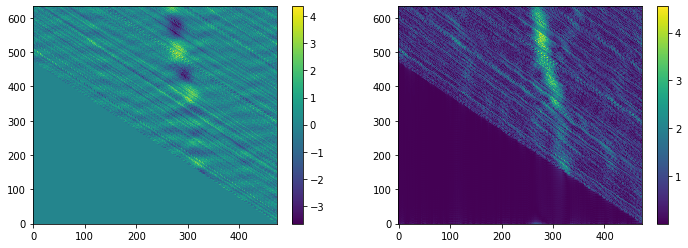

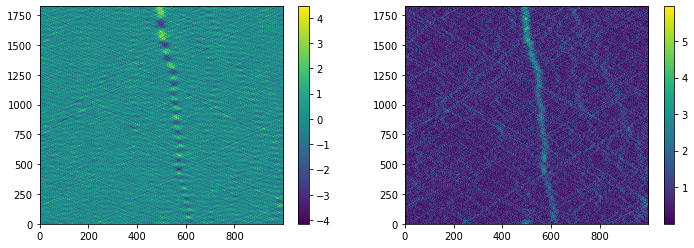

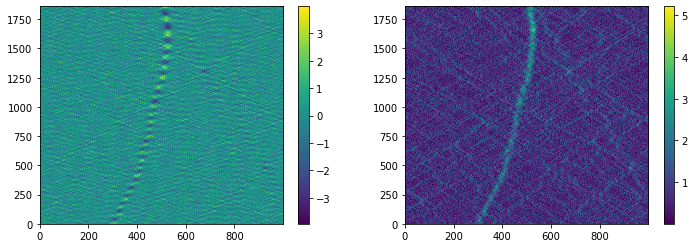

...

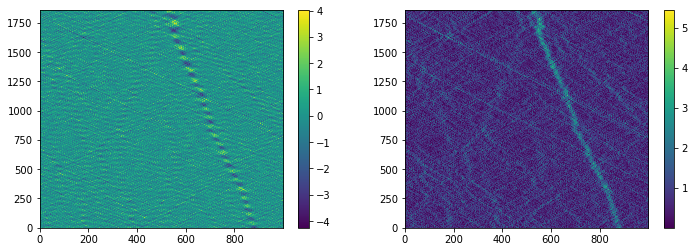

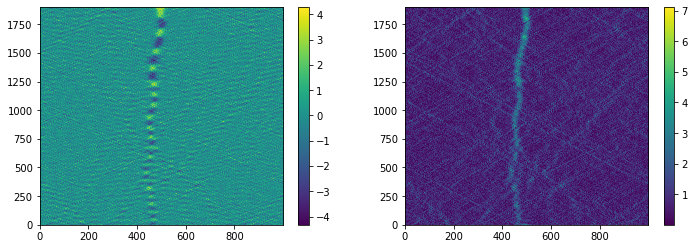

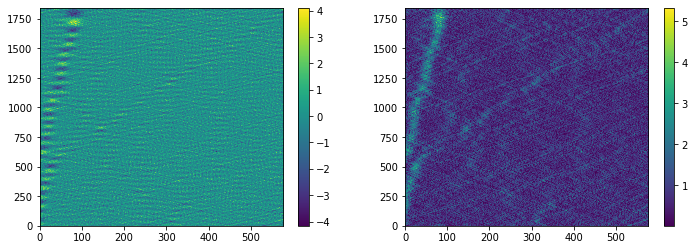

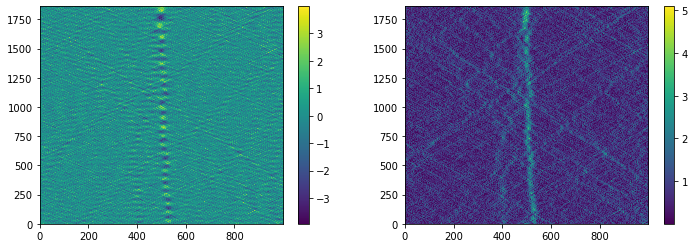

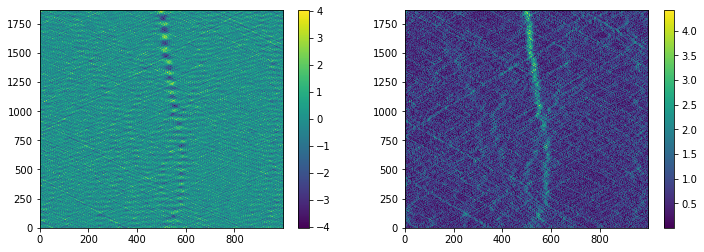

In [106]:
for bubble in newBubbleData[::]:
    bubble = bubble[:time_at_fraction(bubble, 0.1, 4)]
    bubble = bubble-np.mean(bubble)
    # Free field power spectrum
#    PSFilter = np.fft.ifft([(1/phi0/np.sqrt(2*lenLat))**2 / ((k*dk)**2. + m2eff)**0.5 for k in range(len(bubble[0]))])
#    PSFilter = np.fft.fft(PSFilter/np.sum(PSFilter))
#    bubble = [np.fft.ifft(np.fft.fft(slice)*PSFilter).real for slice in bubble]

    w = np.fft.fftfreq(np.shape(bubble)[0])
    FD = np.fft.fft(bubble, axis = 0)
    FD[w<=0,:]=0
    FD[w>0,:]*=2
    HD = np.fft.ifft(FD, axis = 0)

    fig, ax = plt.subplots(1, 2, figsize=(12,4))
    im1 = ax[0].imshow(bubble, aspect='auto', interpolation='none', origin='lower')
    im2 = ax[1].imshow(np.abs(HD), aspect='auto', interpolation='none', origin='lower')
    clb = plt.colorbar(im1, ax = ax[0])
    clb = plt.colorbar(im2, ax = ax[1])

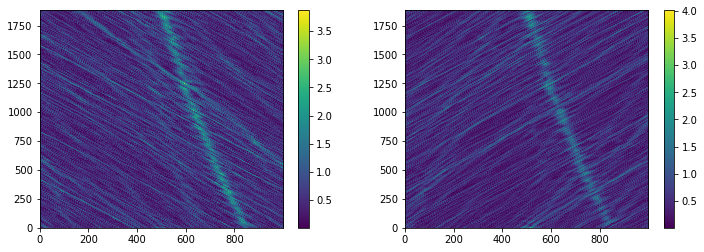

In [21]:
tw = np.fft.fftfreq(np.shape(bubble)[0])
xw = np.fft.fftfreq(np.shape(bubble)[1])
tFD = np.fft.fft(bubble, axis = 0)
xFD = np.fft.fft(bubble, axis = 1)
xFD[:,xw<0] = 0
xFD[:,xw>0] *= 2
tFD[tw<0,:] = 0
tFD[tw>0,:] *= 2
tHD = np.fft.ifft(tFD, axis = 0)
xHD = np.fft.ifft(xFD, axis = 1)

lFD = np.fft.fft(tHD, axis = 1)
rFD = np.fft.fft(xHD, axis = 0)
lFD[:,xw<0] = 0
lFD[:,xw>0] *= 2
rFD[tw>0,:] = 0
rFD[tw<0,:] *= 2
lHD = np.fft.ifft(lFD, axis = 1)
rHD = np.fft.ifft(rFD, axis = 0)

fig, ax = plt.subplots(1, 2, figsize=(12,4))
im1 = ax[0].imshow(np.abs(lHD), aspect='auto', interpolation='none', origin='lower')
im2 = ax[1].imshow(np.abs(rHD), aspect='auto', interpolation='none', origin='lower')
plt.colorbar(im1, ax = ax[0]); plt.colorbar(im2, ax = ax[1])

In [22]:
T, N = len(bubble), len(bubble[0]); print(T, N)

w = np.fft.fftfreq(np.shape(bubble)[0])
FD = np.fft.fft(bubble, axis = 0)
FD[w<=0,:]=0
FD[w>0,:]*=2
HD = np.fft.ifft(FD, axis = 0)

aHD = np.abs(HD)
aHD = np.asarray([gaussian_filter1d(i, sigma=10) for i in aHD])

amp = 4
t = aHD**amp/np.sum(aHD**amp, axis=1)[:,None] 
SB = t*np.arange(N)[None,:]
xt = np.sum(SB, axis=1)

1882 1000


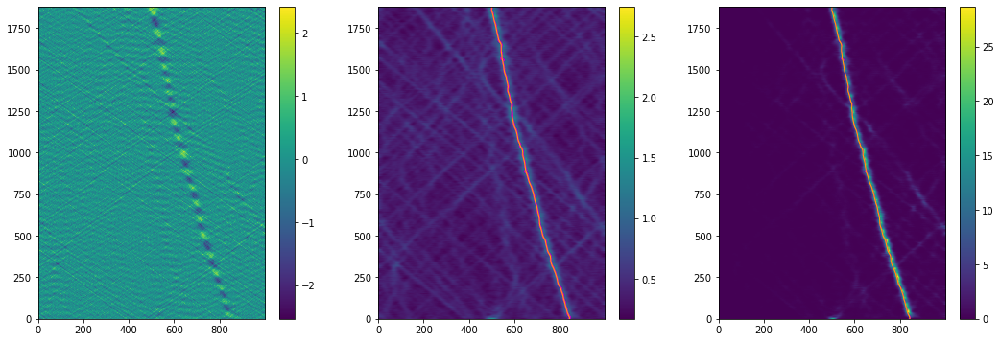

In [23]:
def get_HT(array):  
    array = array-np.mean(array)
    w = np.fft.fftfreq(np.shape(array)[0])
    FD = np.fft.fft(array, axis = 0)
    FD[w<=0,:]=0
    FD[w>0,:]*=2
    HD = np.fft.ifft(FD, axis = 0)
    return np.abs(HD)

def get_osc_trajectory(array, extent):
    # find maximum value in array
    flattened = chain.from_iterable(array)
    max_idx, max_val = max(enumerate(flattened), key=op.itemgetter(1))
    row = max_idx // N
    col = max_idx % N
#    print(array[row][col] == max_val, max_val, array[row][col], row, col)
#    ax[axis].plot(col, row, 'ro', ms=10)

    # use as starting point for oscillon trajectory
#    print(col, row)
    maxLine = []
    CCol = col
    for rr in range(row)[::-1]:
        if rr == row-1:
            col = CCol
        colmin = col - extent
        colmax = col + extent+1
        val = 0
        for cc in range(colmin, colmax):
            cc = cc%N
            if array[rr][cc] > val:
                val = array[rr][cc]
                col = cc
        maxLine.append(col)
    maxLine = maxLine[::-1]
    for rr in range(row, T):
        if rr == row:
            col = CCol
        colmin = col - extent
        colmax = col + extent+1
        val = 0
        for cc in range(colmin, colmax):
            cc = cc%N
            if array[rr][cc] > val:
                val = array[rr][cc]
                col = cc
        maxLine.append(col)
    return maxLine

fig, ax = plt.subplots(1, 3, figsize=(18,6))
im1 = ax[0].imshow(HD.real, aspect='auto', interpolation='none', origin='lower') #original
im2 = ax[1].imshow(aHD, aspect='auto', interpolation='none', origin='lower') #hilbert transform amplitude
# power spectrum method
im3 = ax[2].imshow(SB, aspect='auto', interpolation='none', origin='lower') #power spectrum

maxLine1 = get_osc_trajectory(aHD, extent=10)
ax[1].plot(maxLine1, np.arange(T), 'm', linewidth='2')
maxLine1 = gaussian_filter1d(maxLine1, sigma=10)
ax[1].plot(maxLine1, np.arange(T), 'orange', linewidth='1')

maxLine2 = get_osc_trajectory(SB, extent=10)
ax[2].plot(maxLine2, np.arange(T), 'm', linewidth='1')
maxLine2 = gaussian_filter1d(maxLine2, sigma=10)
ax[2].plot(maxLine2, np.arange(T), 'orange', linewidth='1')

plt.colorbar(im1, ax = ax[0]); plt.colorbar(im2, ax = ax[1]); plt.colorbar(im3, ax = ax[2])

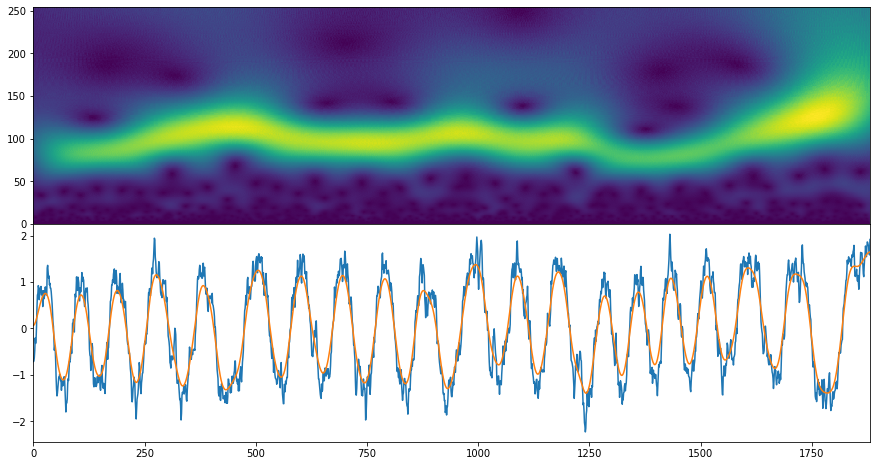

In [132]:
# construct oscillon trajectory from alg above
listcoords = maxLine1
oscillonTraj = np.asarray([[i,j] for i,j in zip(np.arange(T), listcoords)])
# field value along trajectory
oscillonAmp = [bubble[i][j] for i,j in zip(oscillonTraj[:,0], oscillonTraj[:,1])]

# wavelet transform on oscillon maplitude
C,B     = 1,1 # center, bandwidth # C = freq to investigate, B = bandwidth
wavelet = "cmor%f_%f"%(C,B)
dt      = 1
scales  = np.arange(1,256)
CC, f   = pywt.cwt(oscillonAmp, scales, wavelet, sampling_period=dt)

fig, (ax1,ax2) = plt.subplots(2, 1, figsize=(15, 2*4),gridspec_kw=dict(hspace=0),sharex=True)
ax1.imshow(np.abs(CC), aspect='auto', interpolation='none', origin='lower')
# plot field value along trajectory
ax2.plot(oscillonAmp)
ax2.plot(gaussian_filter1d(oscillonAmp, sigma=10))

### FT of Oscillon Signal

In [185]:
saveTFreqs, saveTPS, oscillonAmp = [], [], []
for bubble in newBubbleData[::]:
    tcut = time_at_fraction(bubble, 0.1, 4) # cut out bubble to get good background average
    bubble = bubble[tcut-1000:tcut]
    if len(bubble) < 500:
        continue
    bubble = bubble-np.mean(bubble)
    
    # smoothen using free field power spectrum as window
    bubble = [np.fft.ifft(np.fft.fft(slice)*PSFilter[:len(bubble[0])]).real for slice in bubble]

    aHD = get_HT(bubble)
    aHD = np.asarray([gaussian_filter1d(i, sigma=10) for i in aHD])
    T, N = len(bubble), len(bubble[0])

    maxLine = get_osc_trajectory(aHD, extent=10)

    # construct oscillon trajectory from alg above
    listcoords = gaussian_filter1d(maxLine, sigma=10)
    oscillonTraj = np.asarray([[i,j] for i,j in zip(np.arange(T), listcoords)])
    # field value along trajectory
    oscillonAmp.append([bubble[i][j] for i,j in zip(oscillonTraj[:,0], oscillonTraj[:,1])])
    
    avOscillon = np.fft.fft(oscillonAmp[-1])
    PS = np.conj(avOscillon)*avOscillon
    coords = np.argwhere(PS>1e4) # separate freqs where there is large field response
    freqs = np.fft.fftfreq(len(avOscillon), d=1) # get frequencies; d = x space units
    freqs = [freqs[i]*len(avOscillon) for i in range(len(freqs)) if i in coords]
    PS = [PS[i].real for i in range(len(PS)) if i in coords]
    saveTFreqs.append(np.asarray(freqs))
    saveTPS.append(np.asarray(PS))

Text(0.5, 0, '$\\omega$')

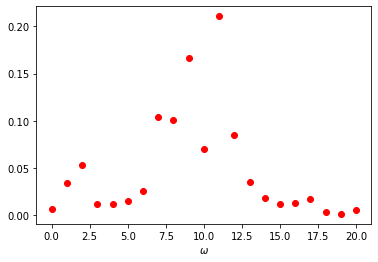

In [186]:
# flat list of all frequencies where response is strong
allTFreqs = np.asarray([item for sublist in saveTFreqs for item in sublist])
allTPS = np.asarray([item for sublist in saveTPS for item in sublist])

# cut duplicates
Tfreqsset = []
for i in allTFreqs:
    if np.abs(i) not in Tfreqsset:
        Tfreqsset.append(np.abs(i))
TPSamp = [0]*len(Tfreqsset)

# add field responses to get relative importance of each mode
for i in range(len(allTFreqs)):
    ind = Tfreqsset.index(np.abs(allTFreqs[i]))
    TPSamp[ind] += allTPS[ind]
TPSamp = TPSamp/np.sum(TPSamp)

# plot frequency vs response; plot mass from frequency and compare with free mass
plt.plot(Tfreqsset, TPSamp, 'ro'); plt.xlabel(r'$\omega$')
#plt.xlim((-1,21))

##### FT in space 

In [24]:
saveXFreqs, saveXPS = [], []
for bubble in newBubbleData[::]:
    tcut = time_at_fraction(bubble, 0.1, 4)
    bubble = bubble[tcut-500:tcut]
    if len(bubble) < 500:
        continue
    bubble = bubble-np.mean(bubble)
    bubble = [np.fft.ifft(np.fft.fft(slice)*PSFilter[:len(bubble[0])]).real for slice in bubble]

    for slice in bubble:
        slice = np.fft.fft(slice)
        PS = np.conj(slice)*slice
        coords = np.argwhere(PS>1e4)
        freqs = np.fft.fftfreq(len(slice), d=1) # get frequencies; d = x space units
        freqs = [freqs[i]*len(slice) for i in range(len(freqs)) if i in coords]
        PS = [PS[i].real for i in range(len(PS)) if i in coords]
        saveXFreqs.append(np.asarray(freqs))
        saveXPS.append(np.asarray(PS))

Text(0.5, 0, '$k$')

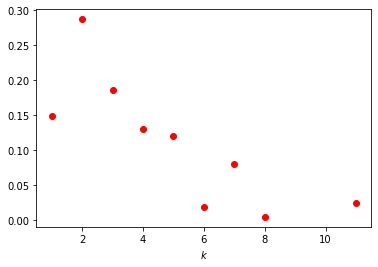

In [191]:
# flat list of all frequencies where response is strong
allXFreqs = np.asarray([item for sublist in saveXFreqs for item in sublist])
allXPS = np.asarray([item for sublist in saveXPS for item in sublist])

# cut duplicates
Xfreqsset = []
for i in allXFreqs:
    if np.abs(i) not in Xfreqsset:
        Xfreqsset.append(np.abs(i))
XPSamp = [0]*len(Xfreqsset)

# add field responses to get relative importance of each mode
for i in range(len(allXFreqs)):
    ind = Xfreqsset.index(np.abs(allXFreqs[i]))
    XPSamp[ind] += allXPS[ind]
Xfreqsset = Xfreqsset[1:]
XPSamp = XPSamp[1:]/np.sum(XPSamp[1:])

# plot frequency vs response; plot mass from frequency and compare with free mass
plt.plot(Xfreqsset, XPSamp, 'ro'); plt.xlabel(r'$k$')

/cm/shared/apps/conda-environments/python37/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in sqrt
  


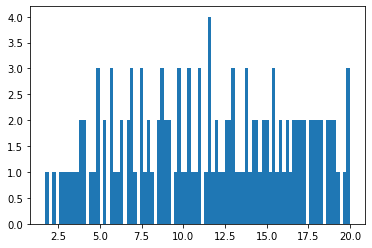

In [250]:
Xfreqsset = np.asarray(np.sort(Xfreqsset))
Tfreqsset = np.asarray(np.sort(Tfreqsset))
masses = np.outer(np.zeros(len(Xfreqsset)), np.zeros(len(Tfreqsset)))
for ii in range(len(masses)):
    for jj in range(len(masses[ii])):
        masses[ii][jj] = np.sqrt(Tfreqsset[jj]**2. - Xfreqsset[ii]**2.)
masses = masses.flatten()
masses.sort()
masses = [i for i in masses if i]
hist = plt.hist(masses, bins=int(len(masses)//2))

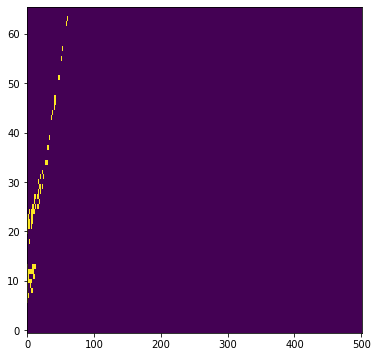

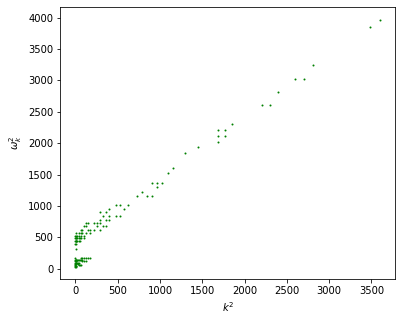

In [53]:
def omega(k, a, m):
    return a*k + m**2

for bubble in newBubbleData[:1:]:
    tcut = time_at_fraction(bubble, 0.1, 4) # cut out bubble to get good background average
    bubble = bubble[tcut-1000:tcut]
    if len(bubble) < 500:
        continue
    bubble = bubble-np.mean(bubble)
    # smoothen using free field power spectrum as window
    bubble = [np.fft.ifft(np.fft.fft(slice)*PSFilter[:len(bubble[0])]).real for slice in bubble]
    T, N = len(bubble), len(bubble[0])
    
    bubble_fftfld = np.fft.rfft2(bubble)[:int(T//15)]
    bubblePS = np.conj(bubble_fftfld)*bubble_fftfld
    maxVal = 5e7

    fig, ax = plt.subplots(1, 1, figsize=(6, 6))
    im2 = plt.imshow(bubblePS.real>maxVal, aspect='auto', interpolation='none', origin='lower')

    # pairs (\omega_k, k)
    bubble_coords = np.argwhere(bubblePS>maxVal)
    # get lists and scale to units
    kkk = bubble_coords[:,1]**2.
    ooo = bubble_coords[:,0]**2.

    # fit to k^2  + m^2= o^2
    popt2, pcov2 = sco.curve_fit(omega, kkk, ooo)

    fig, ax = plt.subplots(1, 1, figsize=(6, 5))
#    plt.plot(kkk, omega(kkk, *popt2), 'b-', label='fit: a=%5.3f, m=%5.3f' % tuple(popt2))
    plt.plot(kkk, ooo, 'go', ms=1)
    ax.set_xlabel(r'$k^2$'); ax.set_ylabel(r'$\omega_k^2$')#; plt.legend()

### Average Oscillon Signal

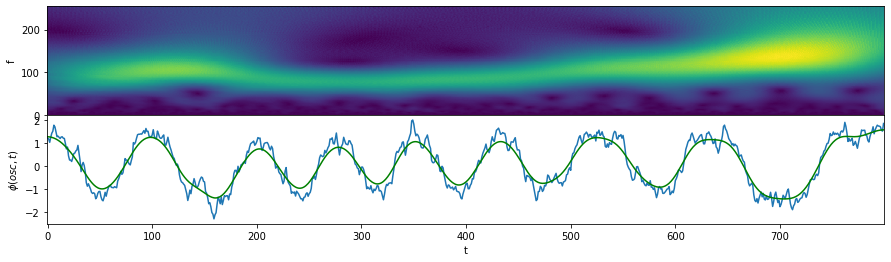

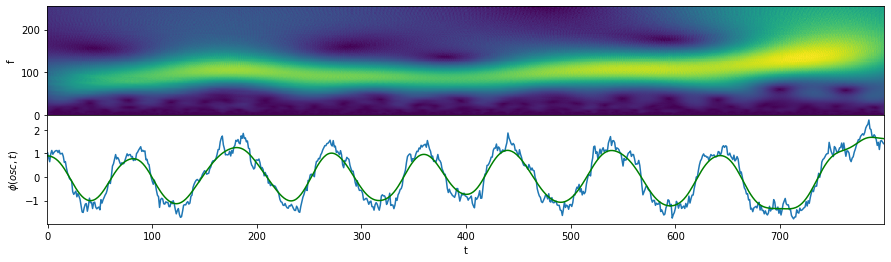

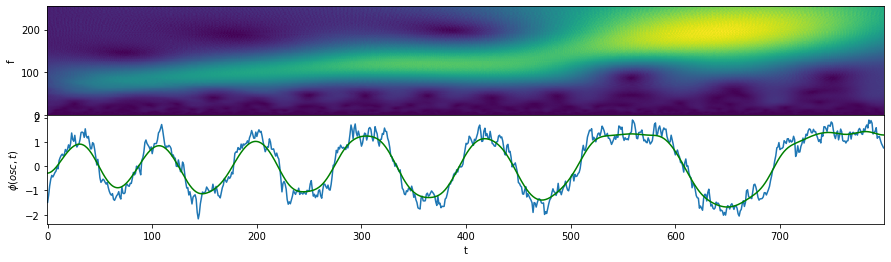

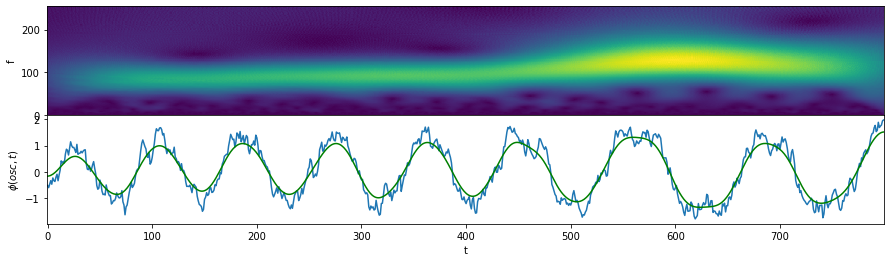

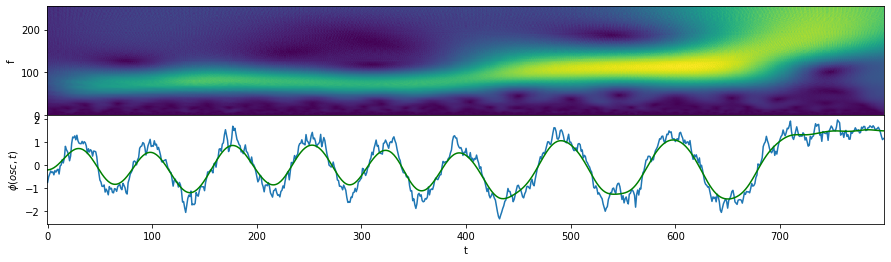

...

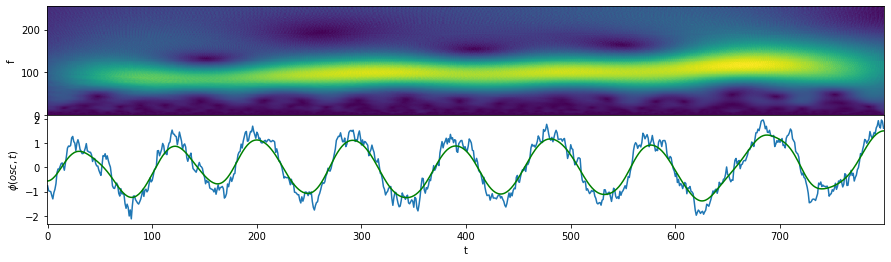

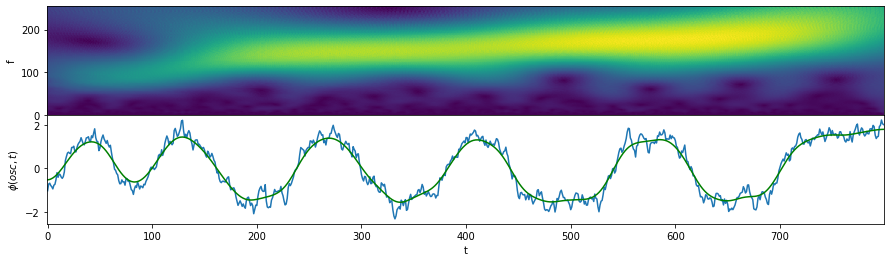

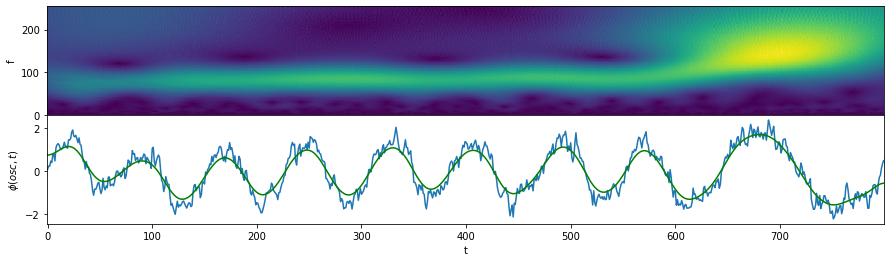

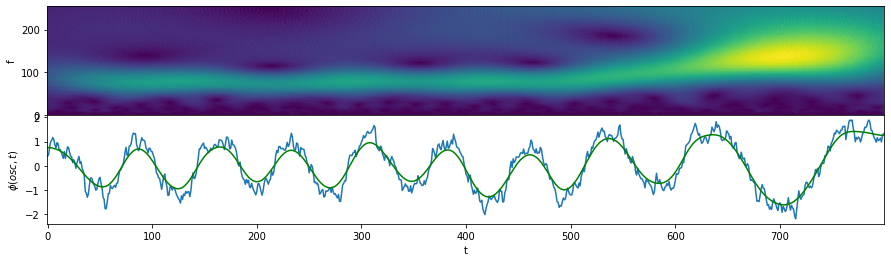

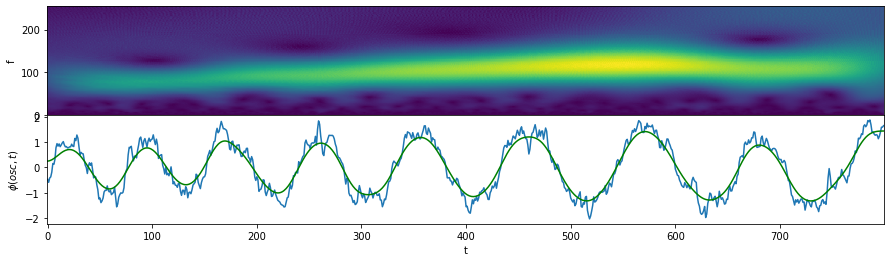

In [174]:
oscillonAmp, oscillonWT = [], []
for bubble in newBubbleData[::]:
    tcut = time_at_fraction(bubble, 0.1, 4)
    bubble = bubble[tcut-800:tcut]
    if len(bubble) < 500:
        continue
    bubble = bubble-np.mean(bubble, axis=0)
    bubble = [np.fft.ifft(np.fft.fft(slice)*PSFilter[:len(bubble[0])]).real for slice in bubble]

    aHD = get_HT(bubble)
    aHD = np.asarray([gaussian_filter1d(i, sigma=10) for i in aHD])
    T, N = len(bubble), len(bubble[0])

    maxLine = get_osc_trajectory(aHD, extent=10)
    maxLine = gaussian_filter1d(maxLine, sigma=10)

    # construct oscillon trajectory from alg above
    listcoords = maxLine
    oscillonTraj = np.asarray([[i,j] for i,j in zip(np.arange(T), listcoords)])
    # field value along trajectory
    oscillonAmp.append([bubble[i][j] for i,j in zip(oscillonTraj[:,0], oscillonTraj[:,1])])
    
    avOscillon = oscillonAmp[-1]
    # wavelet transform on oscillon maplitude
    C,B     = 0.5,1 # center, bandwidth # C = freq to investigate, B = bandwidth
    wavelet = "cmor%f_%f"%(C,B)
    dt      = 1
    scales  = np.arange(1,256)
    CC, f   = pywt.cwt(avOscillon, scales, wavelet, sampling_period=dt)
    oscillonWT.append(CC)

    fig, (ax1,ax2) = plt.subplots(2, 1, figsize=(15, 2*2),gridspec_kw=dict(hspace=0),sharex=True)
    ax1.imshow(np.abs(CC), aspect='auto', interpolation='none', origin='lower')
    # plot field value along trajectory
    ax2.plot(avOscillon)
    ax2.plot(np.arange(len(avOscillon)), gaussian_filter1d(avOscillon, sigma=10), color='green')
    ax1.set_ylabel('f'); ax2.set_xlabel('t'); ax2.set_ylabel(r'$\phi(osc,t)$'); plt.show()

Text(0, 0.5, '$\\phi(osc,t)$')

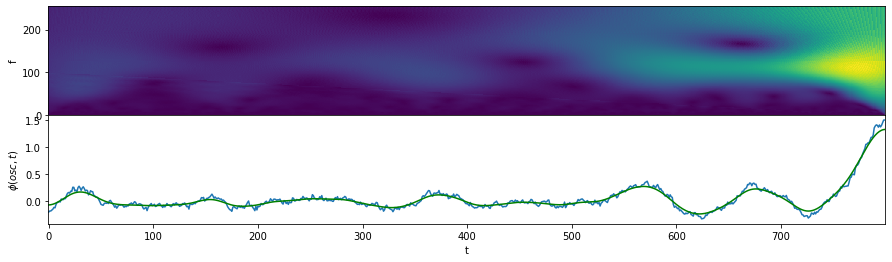

In [179]:
# average oscillon trajectories
def tolerant_mean(arrs):
    lens = [len(i) for i in arrs]
    arr = np.ma.empty((np.max(lens),len(arrs)))
    arr.mask = True
    for idx, l in enumerate(arrs):
        arr[:len(l),idx] = l
    return arr.mean(axis = -1), arr.std(axis=-1)

avOscillon = [jj[::-1] for jj in oscillonAmp]
avOscillon, error = tolerant_mean(avOscillon)
avOscillon, error = avOscillon[::-1], error[::-1]
avWT = np.mean(oscillonWT, axis=0)

fig, ax = plt.subplots(2, 1, figsize=(15, 2*2),gridspec_kw=dict(hspace=0),sharex=True)
ax[0].imshow(np.abs(avWT), aspect='auto', interpolation='none', origin='lower')
# plot field value along trajectory
ax[1].plot(np.arange(T), avOscillon)
ax[1].plot(np.arange(T), gaussian_filter1d(avOscillon, sigma=10), ms=1, color='green')
ax[0].set_ylabel('f'); ax[1].set_xlabel('t'); ax[1].set_ylabel(r'$\phi(osc,t)$')

### Dispersion Relation and Mass 

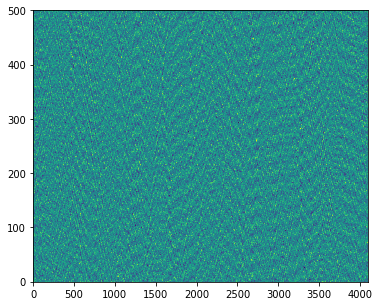

In [50]:
for ss in ['free']:
#for ss in ['thin']:
    nSims, lamb, m2eff, phi0, V, instanton_location, sim_location, coleman_profile, plots_file, pickle_location, cutout_location, suffix = source(ss)
    for sim in range(1,2): # for 'thin' simulation 1 is late time only
        simulation = np.genfromtxt(sim_location(sim))
        nT = len(simulation)//nLat
        simulation_free = np.reshape(simulation, (nT, nLat))
#        simulation_bubble = np.reshape(simulation, (nT, nLat))

        fig, ax = plt.subplots(1, 1, figsize=(6, 5))
        plt.imshow(simulation_free, aspect='auto', interpolation='none', origin='lower')
#        plt.imshow(simulation_bubble, aspect='auto', interpolation='none', origin='lower')

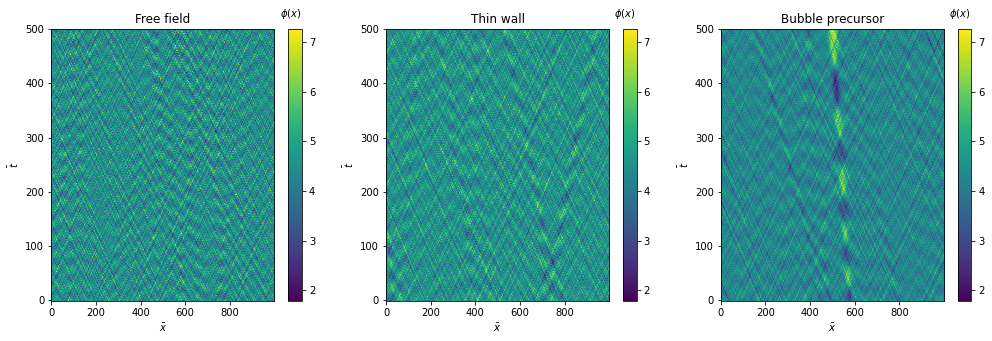

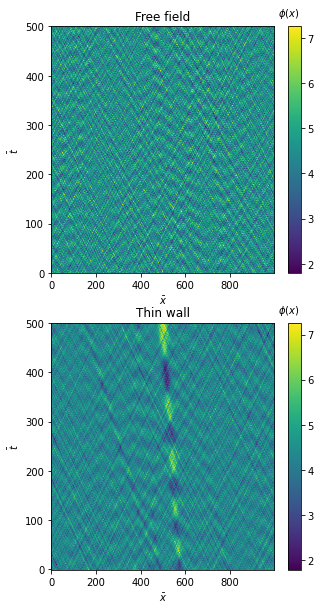

0.5291502622129182


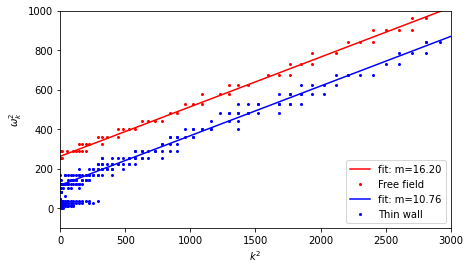

In [117]:
freefield = simulation_free - np.mean(simulation_free) # free field
bubble = simulation_bubble - np.mean(simulation_bubble) # periodic potential

oscillon = newBubbleData[0]
tcut = time_at_fraction(oscillon, 0.12, 4) # cut out bubble to get good background average
oscillon = oscillon[:tcut]
#oscillon = [np.fft.ifft(np.fft.fft(slice)*PSFilter[:len(oscillon[0])]).real for slice in oscillon]
oscillon = oscillon-np.mean(oscillon)

bT, bN = min(len(freefield), len(oscillon)), min(len(freefield[0]), len(oscillon[0]))
freefield = freefield[:bT, :bN]
bubble = bubble[-bT:, -bN:]
oscillon = oscillon[-bT:, :bN]

fig, ax = plt.subplots(1, 3, figsize=(17, 5))
ax[0].imshow(freefield, aspect='auto', interpolation='none', origin='lower')
ax[1].imshow(bubble, aspect='auto', interpolation='none', origin='lower')
ax[2].imshow(oscillon, aspect='auto', interpolation='none', origin='lower')

title_list = ['Free field', 'Thin wall', 'Bubble precursor']
for i in range(len(ax)):
    clb = plt.colorbar(im, ax = ax[i])
    clb.set_label(r'$\phi(x)$', labelpad=-25, y=1.08, rotation=0)
    ax[i].set_xlabel(r'$\bar{x}$')
    ax[i].set_ylabel(r'$\bar{t}$')
    ax[i].set_title(title_list[i])
plt.show()

fig, ax = plt.subplots(2, 1, figsize=(5, 10))
ax[0].imshow(freefield, aspect='auto', interpolation='none', origin='lower')
ax[1].imshow(oscillon, aspect='auto', interpolation='none', origin='lower')

title_list = ['Free field', 'Thin wall']#, 'Bubble precursor']
for i in range(len(ax)):
    clb = plt.colorbar(im, ax = ax[i])
    clb.set_label(r'$\phi(x)$', labelpad=-25, y=1.08, rotation=0)
    ax[i].set_xlabel(r'$\bar{x}$')
    ax[i].set_ylabel(r'$\bar{t}$')
    ax[i].set_title(title_list[i])
plt.show()

free_fftfld = np.fft.rfft2(freefield)[:int(bT//2)]
bubble_fftfld = np.fft.rfft2(bubble)[:int(bT//2)]
osc_fftfld = np.fft.rfft2(oscillon)[:int(bT//2)]
maxVal = 3e7

freePS = np.conj(free_fftfld)*free_fftfld
bubblePS = np.conj(bubble_fftfld)*bubble_fftfld
oscPS = np.conj(osc_fftfld)*osc_fftfld

#fig, ax = plt.subplots(1, 2, figsize=(18, 5))
#im1 = ax[0].imshow(freePS>maxVal, aspect='auto', interpolation='none', origin='lower')
#im2 = ax[1].imshow(bubblePS>maxVal, aspect='auto', interpolation='none', origin='lower')

# pairs (\omega_k, k)
free_coords = np.argwhere(freePS>maxVal)
bubble_coords = np.argwhere(bubblePS>maxVal)
osc_coords = np.argwhere(oscPS>maxVal)

# units
alpha = 8.
dk = 2.*np.pi/lenLat
dt = dx/alpha
dtout = dt*alpha

# get lists and scale to units
#kk = (free_coords[:,1]*dk)**2.
#oo = (free_coords[:,0]/dtout)**2.
#kkk = (bubble_coords[:,1]*dk)**2.
#ooo = (bubble_coords[:,0]/dtout)**2.
kk = (free_coords[:,1])**2.
oo = (free_coords[:,0])**2.
kkk = (bubble_coords[:,1])**2.
ooo = (bubble_coords[:,0])**2.
kkkk = osc_coords[:,1]**2.
oooo = osc_coords[:,0]**2.

# fit to k^2  + m^2= o^2
def omega(k, a, m):
    return a*k + m**2
popt1, pcov1 = sco.curve_fit(omega, kk, oo)
popt2, pcov2 = sco.curve_fit(omega, kkk, ooo)
popt3, pcov3 = sco.curve_fit(omega, kkkk, oooo)

print(np.sqrt(m2eff))
fig, ax = plt.subplots(1, 1, figsize=(7, 4))
plt.plot(kk, omega(kk, *popt1), 'r-', label='fit: m=%5.2f'%popt1[-1])#a=%5.3f, m=%5.3f' % tuple(popt1))
plt.plot(kk, oo, 'ro', ms=2, label='Free field')

plt.plot(kkk, omega(kkk, *popt2), 'b-', label='fit: m=%5.2f'%popt2[-1])#a=%5.3f, m=%5.3f' % tuple(popt2))
plt.plot(kkk, ooo, 'bo', ms=2, label='Thin wall')

#plt.plot(kkkk, omega(kkkk, *popt3), 'g-', label='fit: m=%5.2f'%popt3[-1])#a=%5.3f, m=%5.3f' % tuple(popt2))
plt.plot(kkkk, oooo, 'bo', ms=2)#, label='Bubble precursor')

plt.xlim((0,3000))
plt.ylim((-100,1000))
ax.set_xlabel(r'$k^2$'); ax.set_ylabel(r'$\omega_k^2$')
plt.legend(loc='lower right')